In [1]:
import sys

sys.path.insert(0, "..")

import random
import numpy as np
from sklearn.preprocessing import LabelEncoder

import plotly.express as px
import plotly.graph_objects as go
import pandas as pd
import random
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import torch
import pyro
import foraging_toolkit as ft


import torch.nn.functional as F
import pyro.distributions as dist
import pyro.optim as optim
from pyro.nn import PyroModule
from pyro.infer.autoguide import (
    AutoNormal,
    AutoDiagonalNormal,
    AutoMultivariateNormal,
    init_to_mean,
    init_to_value,
)
from pyro.contrib.autoguide import AutoLaplaceApproximation
from pyro.infer import SVI, Trace_ELBO
from pyro.optim import Adam
from pyro.infer import Predictive
from pyro.infer import MCMC, NUTS

import os
import logging

logging.basicConfig(format="%(message)s", level=logging.INFO)
smoke_test = "CI" in os.environ

[Günzel et al.](https://www.sciencedirect.com/science/article/pii/S2589004223004650?via%3Dihub#undtbl1) studied the balance between the use of social and personal information in foraging locust. Here we use one of the [associated datasets](https://zenodo.org/record/7541780), one with two equally high quality patches, Patch A located at (0.68074	-0.03068), and Patch B located at (-0.69292	-0.03068) - patch locations are in a separate .mat file, which can be accessed using Matlab or GNU Octave. The positions are normalized. 


In [2]:
subset_starts = 420
subset_ends = 520

locust = ft.load_and_clean_locust(path = "locust_data/15EQ20191202_tracked.csv",
                                  desired_frames = 1350,
                                  grid_size=45,
                                  rewards_x = [0.68074, -0.69292],
                                  rewards_y = [-0.03068, -0.03068],
                                  subset_starts= subset_starts,
                                  subset_ends = subset_ends,)


original_frames: 45000
original_shape: (675000, 4)
resulting_frames: 1350
resulting_shape: (20250, 4)
min_time 1
max_time 1350


In [3]:
locust['subset'].birdsDF.head()

,x,y,time,bird,type
209250,9.0,22.0,420,1,locust
209251,7.0,21.0,420,2,locust
209252,5.0,35.0,420,3,locust
209253,12.0,40.0,420,4,locust
209254,11.0,22.0,420,5,locust


In [4]:
loc_subset = locust['subset']

loc_subset.birdsDF.head()


,x,y,time,bird,type
209250,9.0,22.0,420,1,locust
209251,7.0,21.0,420,2,locust
209252,5.0,35.0,420,3,locust
209253,12.0,40.0,420,4,locust
209254,11.0,22.0,420,5,locust


In [5]:
#  feel free to check out the raw data
ft.animate_birds(loc_subset, plot_rewards=True, width=600, height=600, point_size=10)


In [6]:
loc_subset = ft.derive_predictors(loc_subset, 
                                        rewards_decay= 1,
                                        visibility_range= 8,
                                        getting_worse = .3,
                                        optimal = 6,
                                        proximity_decay = .3,
                                        generate_communicates=True,
                                        info_time_decay=8,
                                        info_spatial_decay=0.05,
                                        finders_tolerance = 2, 
                                         time_shift= subset_starts - 1 )

2023-08-30 12:20:25,231:  traces done
2023-08-30 12:20:29,776:  visibility done
2023-08-30 12:20:33,618:  proximity done
2023-08-30 12:20:34,751:  how_far done
2023-08-30 12:20:35,394:  derivedDF done
2023-08-30 12:20:35,395:  starting to generate communicates
2023-08-30 12:20:56,137:  communicates done


   x   y     trace  time  trace_standardized  distance  distance_x  \
0  1  11  0.000004   420           -0.146114   8.00000         0.0   
1  1  12  0.000009   420           -0.146000   7.00000         0.0   
2  1  13  0.000020   420           -0.145739   6.00000         0.0   
3  1  14  0.000045   420           -0.145162   7.81025         6.0   
4  1  14  0.000045   420           -0.145162   5.00000         0.0   

   distance_y    visibility  bird  proximity  proximity_standardized  \
0         8.0  6.123234e-17    14   1.008570               -1.985058   
1         7.0  1.950903e-01    14   1.292949               -1.533528   
2         6.0  3.826834e-01    14   1.626731               -1.003559   
3         5.0  3.724877e-02     9   2.606918               -1.525525   
4         5.0  5.555702e-01    14   1.969315               -0.459613   

   how_far_squared  how_far_squared_scaled  communicate  \
0            100.0                0.652778          0.0   
1             81.0          

In [10]:
loc_subset.communicatesDF.head()

,x,y,bird,time,communicate,communicate_standardized
0,1,1,1,60,0.0,0
1,1,2,1,60,0.0,0
2,1,3,1,60,0.0,0
3,1,4,1,60,0.0,0
4,1,5,1,60,0.0,0


In [7]:
loc_subset.derivedDF.head()

,x,y,trace,time,trace_standardized,distance,distance_x,distance_y,visibility,bird,proximity,proximity_standardized,how_far_squared,how_far_squared_scaled,communicate,communicate_standardized
0,1,11,0.000004,1,-0.146114,8.00000,0.0,8.0,6.123234e-17,14,1.008570,-1.985058,100.0,0.652778,0.0,-0.096007
1,1,12,0.000009,1,-0.146000,7.00000,0.0,7.0,1.950903e-01,14,1.292949,-1.533528,81.0,0.718750,0.0,-0.096007
2,1,13,0.000020,1,-0.145739,6.00000,0.0,6.0,3.826834e-01,14,1.626731,-1.003559,64.0,0.777778,0.0,-0.096007
3,1,14,0.000045,1,-0.145162,7.81025,6.0,5.0,3.724877e-02,9,2.606918,-1.525525,61.0,0.788194,0.0,-0.096007
4,1,14,0.000045,1,-0.145162,5.00000,0.0,5.0,5.555702e-01,14,1.969315,-0.459613,49.0,0.829861,0.0,-0.096007


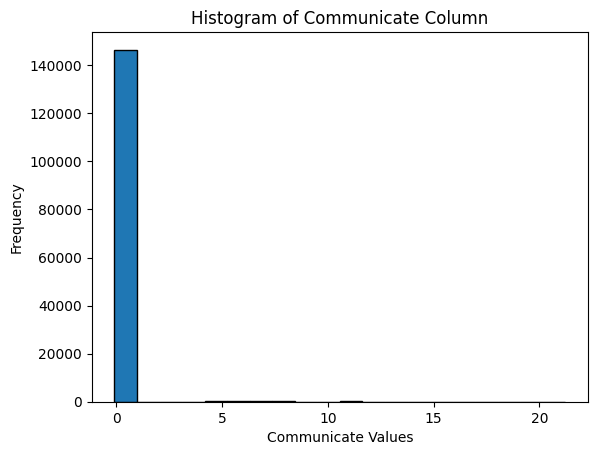

In [8]:
plt.hist(loc_subset.derivedDF['communicate_standardized'], bins=20, edgecolor='k')
plt.xlabel('Communicate Values')
plt.ylabel('Frequency')
plt.title('Histogram of Communicate Column')
plt.show()

In [11]:
# sanity check for thining: we don't want 
# large step size max
loc_subset.step_size_max
# and it's probably enough to have visibility
# at 2 * step size max for computational ease


4.0

In [12]:
loc_subset.communicatesDF.head()

,x,y,bird,time,communicate,communicate_standardized
0,1,1,1,60,0.0,0
1,1,2,1,60,0.0,0
2,1,3,1,60,0.0,0
3,1,4,1,60,0.0,0
4,1,5,1,60,0.0,0


In [13]:
loc_subset.derivedDF.head()

,x,y,trace,time,trace_standardized,distance,distance_x,distance_y,visibility,bird,proximity,proximity_standardized,how_far_squared,how_far_squared_scaled,communicate,communicate_standardized
0,1,11,0.000004,1,-0.146114,8.00000,0.0,8.0,6.123234e-17,14,1.008570,-1.985058,100.0,0.652778,0.0,-0.096007
1,1,12,0.000009,1,-0.146000,7.00000,0.0,7.0,1.950903e-01,14,1.292949,-1.533528,81.0,0.718750,0.0,-0.096007
2,1,13,0.000020,1,-0.145739,6.00000,0.0,6.0,3.826834e-01,14,1.626731,-1.003559,64.0,0.777778,0.0,-0.096007
3,1,14,0.000045,1,-0.145162,7.81025,6.0,5.0,3.724877e-02,9,2.606918,-1.525525,61.0,0.788194,0.0,-0.096007
4,1,14,0.000045,1,-0.145162,5.00000,0.0,5.0,5.555702e-01,14,1.969315,-0.459613,49.0,0.829861,0.0,-0.096007


In [16]:
ft.animate_birds(loc_subset, plot_rewards=True, width = 600,
                  height = 600, point_size = 10, plot_traces=True,
                   trace_multiplier= 10)

In [17]:
#feel free to uncomment and play around
ft.animate_birds(loc_subset, plot_rewards=True, width = 600,
                  height = 600, point_size = 10, 
                  plot_proximity = 6,
                  plot_traces=True, trace_multiplier= 15)


In [21]:
loc_subset.communicatesDF['time'].unique()


array([60])

In [19]:
ft.animate_birds(loc_subset, plot_rewards=True, width = 600,
                  height = 600, point_size = 10, 
                  plot_visibility=3,
                  plot_communicate = 3,
                  plot_traces=True, communicate_multiplier = 
                  8, trace_multiplier= 5)

   x  y         bird  time  communicate  communicate_standardized  who
0  1  1  communicate    50     9.329707                 -0.532216    3
1  1  2  communicate    50     9.773645                 -0.432811    3
2  1  3  communicate    50    10.236584                 -0.329151    3
3  1  4  communicate    50    10.718943                 -0.221143    3
4  1  5  communicate    50    11.221045                 -0.108715    3


In [ ]:
# ft.animate_birds(loc_initial, plot_rewards=True, width = 600,
#                   height = 600, point_size = 10, 
#                   plot_visibility=7, plot_traces=True)

In [13]:

def prep_data_for__communicators_inference(sim_derived):

    print("Initial dataset size:", sim_derived.derivedDF.shape[0])
    df = sim_derived.derivedDF.copy().dropna()
    print("Complete cases:", df.shape[0])
    #large drop expected as we only care about points within birds' visibility range
    #and many communicates are outside of it

    data = torch.tensor(df[["trace_standardized", "proximity_standardized", "visibility", "communicate_standardized",
                          "how_far_squared_scaled"]].values, dtype=torch.float32)


    trace, proximity, visibility, communicate, how_far = data[:, 0], data[:, 1], data[:, 2], data[:, 3], data[:, 4]
    
    
    print(str(len(proximity)) + " data points prepared for inference.")
    
    return trace, proximity, visibility, communicate, how_far


proximity, trace, visibility, communicate, how_far_score = prep_data_for__communicators_inference(loc_subset)

Initial dataset size: 117036
Complete cases: 99623
99623 data points prepared for inference.


In [8]:
proximity = (proximity - proximity.min()) / (proximity.max() - proximity.min())
trace = (trace - trace.min()) / (trace.max() - trace.min())
visibility = (visibility - visibility.min()) / (visibility.max() - visibility.min())
communicate = (communicate - communicate.min()) / (communicate.max() - communicate.min())

In [14]:

ft.visualise_bird_predictors(trace, proximity, how_far_score, com = communicate)

In [9]:
def summary(samples):
    site_stats = {}
    for site_name, values in samples.items():
        marginal_site = pd.DataFrame(values)
        describe = marginal_site.describe(percentiles=[.05, 0.25, 0.5, 0.75, 0.95]).transpose()
        site_stats[site_name] = describe[["mean", "std", "5%", "25%", "50%", "75%", "95%"]]
    return site_stats

/home/rafal/.local/lib/python3.10/site-packages/torch/cuda/__init__.py:546: UserWarning:

Can't initialize NVML



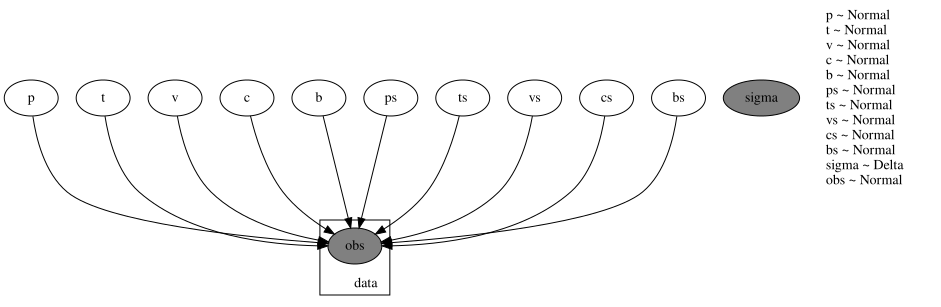

In [15]:
def model_sigmavar_com(proximity, trace, visibility, communicate, how_far_score):
    p = pyro.sample("p", dist.Normal(0, .3))
    t = pyro.sample("t", dist.Normal(0, .3))
    v = pyro.sample("v", dist.Normal(0, .3))
    c = pyro.sample("c", dist.Normal(0, .3))
    b = pyro.sample("b", dist.Normal(.5, .3))

    ps = pyro.sample("ps", dist.Normal(0, .3))
    ts = pyro.sample("ts", dist.Normal(0, .3))
    vs = pyro.sample("vs", dist.Normal(0, .3))
    cs = pyro.sample("cs", dist.Normal(0, .3))
    bs = pyro.sample("bs", dist.Normal(.2, .3))


    sigmaRaw = bs + ps * proximity + ts * trace + vs * visibility + cs * communicate
    sigma = pyro.deterministic("sigma", F.softplus(sigmaRaw))
    mean = b + p * proximity + t * trace + v * visibility + c * communicate

    with pyro.plate("data", len(how_far_score)):
        pyro.sample("obs", dist.Normal(mean, sigma), obs=how_far_score)

pyro.render_model(model_sigmavar_com, model_args=(proximity, trace, visibility,
                                               communicate, how_far_score),
                        render_distributions=True)

In [16]:
# Inference with SVI
# note how long this takes
# and compare time with MCM 

guide = AutoMultivariateNormal(model_sigmavar_com, init_loc_fn=init_to_mean)
svi = SVI(model_sigmavar_com,
        guide,
        optim.Adam({"lr": .01}),
        loss=Trace_ELBO())

iterations = []
losses = []

pyro.clear_param_store()
num_iters = 1000
for i in range(num_iters):
    elbo = svi.step(proximity, trace, visibility, communicate, how_far_score)
    iterations.append(i)
    losses.append(elbo)
    if i % 200 == 0:
        logging.info("Elbo loss: {}".format(elbo))


2023-08-25 13:40:10,936:  Elbo loss: 82995.26711285114
2023-08-25 13:40:13,367:  Elbo loss: -79143.12222409248
2023-08-25 13:40:15,519:  Elbo loss: -144438.78466176987
2023-08-25 13:40:17,887:  Elbo loss: -148763.53153163195
2023-08-25 13:40:20,279:  Elbo loss: -147615.0024843216


In [17]:
num_samples = 1000
predictive = Predictive(model_sigmavar_com, guide=guide, 
                        num_samples=num_samples,
                        return_sites = ["t", "p", "c"])
communicate_sigmavar = {k: v.flatten().reshape(num_samples, -1).detach().cpu().numpy()
            for k, v in predictive(proximity, trace, visibility, communicate, how_far_score).items()
            if k != "obs"}

for site, values in ft.summary(communicate_sigmavar, ["t", "p", "c"]).items():
            print("Site: {}".format(site))
            print(values, "\n")

Site: p
       mean       std        5%       25%       50%       75%       95%
0 -0.006247  0.007622 -0.018197 -0.011277 -0.006627 -0.001051  0.006034 

Site: t
       mean       std       5%       25%     50%       75%       95%
0  0.002548  0.004014 -0.00388 -0.000113  0.0025  0.005148  0.009043 

Site: c
       mean       std        5%      25%       50%       75%       95%
0  0.004532  0.004855 -0.003203  0.00126  0.004379  0.007806  0.012222 



In [18]:
def calculate_R_squared_com(guide):
    predictive = pyro.infer.Predictive(model_sigmavar_com, guide=guide, num_samples=1000)
    predictions = predictive(proximity, trace, visibility, communicate, how_far_score)

    simulated_outcome = ( predictions['b'] + predictions['p'] * proximity +
                      predictions['t'] * trace + predictions['v'] * visibility +
                      predictions['c'] * communicate)

    mean_sim_outcome = simulated_outcome.mean(0).detach().cpu().numpy()

    observed_mean = torch.mean(how_far_score)

    tss = torch.sum((how_far_score - observed_mean) ** 2)
    rss = torch.sum((how_far_score - mean_sim_outcome) ** 2)

    r_squared = 1 - (rss / tss)

    return r_squared.float().item()

print(calculate_R_squared_com(guide))

0.4381874203681946


In [19]:

site_names = ['p', 't', 'c']

svi_p = communicate_sigmavar['p'].flatten().tolist()
#mcmc_p = communicate_sigmavar_mcmc['p'].flatten().tolist()

svi_t = communicate_sigmavar['t'].flatten().tolist()
#mcmc_t = communicate_sigmavar_mcmc['t'].flatten().tolist()


svi_c = communicate_sigmavar['c'].flatten().tolist()
#mcmc_c = communicate_sigmavar_mcmc['c'].flatten().tolist()


site_data = {
#    'Site': site_names * len(svi_p),
    'p': svi_p, # + mcmc_p,
    't': svi_t, # + mcmc_t,
    'c': svi_c, # + mcmc_c,
    'Method': ['SVI'] * len(svi_p) #+ ['MCMC'] * len(mcmc_p)
}

df = pd.DataFrame(site_data)

fig1 = px.histogram(df, x='p',# color='Method',
                     title="Proximity", template='plotly_dark')

fig1.update_layout(autosize=False, width=800, height=400)
fig1.update_traces(opacity=0.4)


fig2 = px.histogram(df, x='t',# color='Method',
                     title="Trace", template='plotly_dark')

fig2.update_layout(autosize=False, width=800, height=400)
fig2.update_traces(opacity=0.4)


fig3 = px.histogram(df, x='c', #color='Method',
                     title="Communicate", template='plotly_dark')

fig3.update_layout(autosize=False, width=800, height=400)
fig3.update_traces(opacity=0.4)


fig1.show()
fig2.show()
fig3.show()

#note: we only had two birds and one food patch, likely will improve with better data

